In [ ]:
!free -h

              total        used        free      shared  buff/cache   available
Mem:            25G        578M         23G        1.1M        1.8G         24G
Swap:            0B          0B          0B


In [ ]:
!nvidia-smi

Wed Dec 21 10:03:30 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   50C    P0    28W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
## Installing Detectron2 ..
!pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)
print(torch.__version__, torch.cuda.is_available())

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 274 kB 4.1 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp38-cp38-linux_x86_64.whl size=44089 sha256=16b4221a9b0f74b0645a494d103c307b7e02a405052be2862ac8d0d1a121a85d
  Stored in directory: /root/.cache/pip/wheels/52/dd/2b/10ff8b0ac81b93946bb5fb9e6749bae2dac246506c8774e6cf
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.2.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/de

In [ ]:
# !git clone https://github.com/facebookresearch/detectron2 detectron2_repo

In [ ]:
# Some basic setup for detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [ ]:
# !rm -rf images.zip images/ data.json
!ls

data.json  images.zip  labelme2coco.py	output	sample_data


In [ ]:
%cd /content
!unzip images.zip

/content
Archive:  images.zip
  inflating: images/image11.jpeg     
  inflating: images/image12.jpeg     
  inflating: images/image15.jpeg     
  inflating: images/image17.jpeg     
  inflating: images/image18.jpeg     
  inflating: images/image20.jpeg     
  inflating: images/image21.jpeg     
  inflating: images/image23.jpeg     
  inflating: images/image231.jpeg    
  inflating: images/image232.jpeg    
  inflating: images/image234.jpeg    
  inflating: images/image235.jpeg    
  inflating: images/image236.jpeg    
  inflating: images/image237.jpeg    
  inflating: images/image238.jpeg    
  inflating: images/image239.jpeg    
  inflating: images/image240.jpeg    
  inflating: images/image241.jpeg    
  inflating: images/image242.jpeg    
  inflating: images/image243.jpeg    
  inflating: images/image244.jpeg    
  inflating: images/image25.jpeg     
  inflating: images/image27.jpeg     
  inflating: images/image29.jpeg     
  inflating: images/image3.jpeg      
  inflating: images/

In [ ]:
from detectron2.data.datasets import register_coco_instances

register_coco_instances("train", {}, "json_annotation_train.json", "path/to/image/dir")
register_coco_instances("val", {}, "json_annotation_val.json", "path/to/image/dir")

In [ ]:
##  Register the dataset instances on detectron2 ..

from detectron2.data.datasets import register_coco_instances
register_coco_instances("sample_3", {}, "/content/data.json", "/content/images")

sample_metadata = MetadataCatalog.get("sample_3")
dataset_dicts = DatasetCatalog.get("sample_3")

WARNING [12/21 10:42:03 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/21 10:42:03 d2.data.datasets.coco]: Loaded 29 images in COCO format from /content/data.json


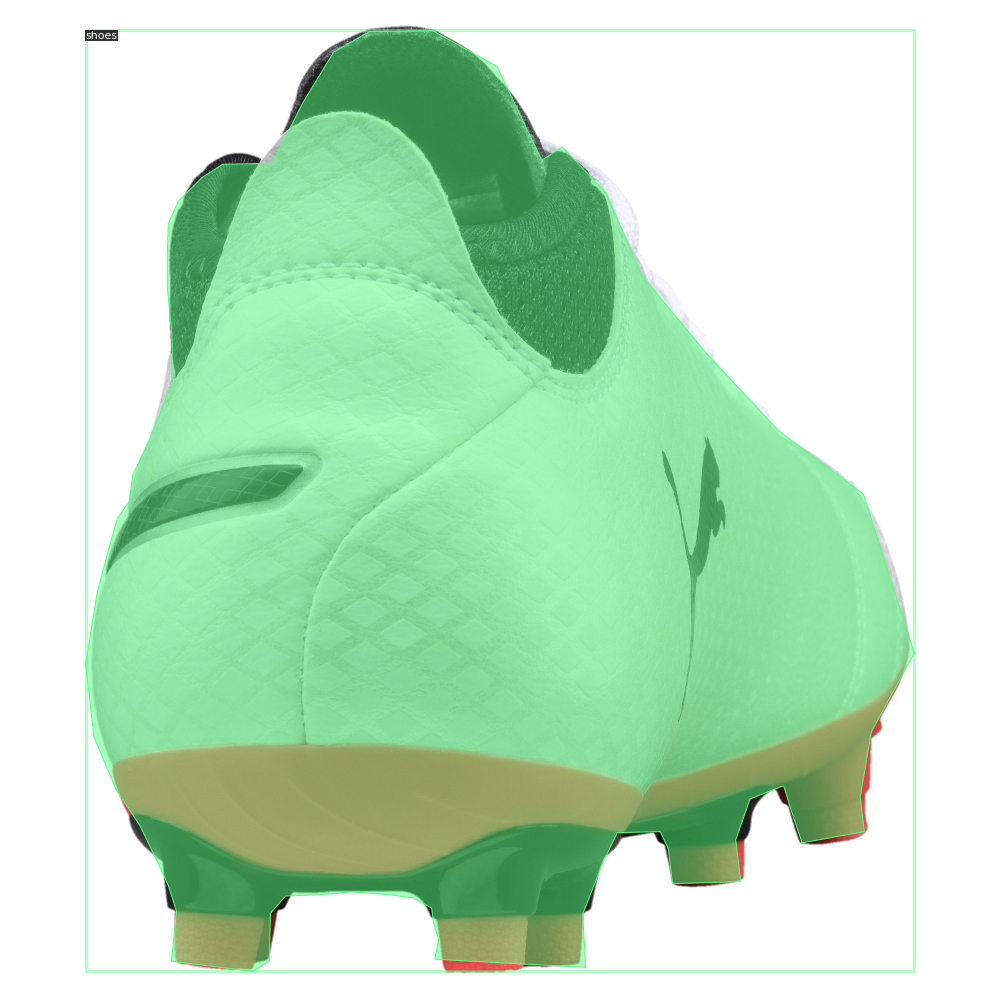

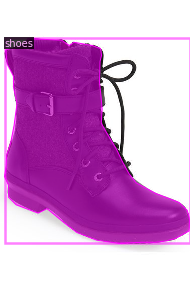

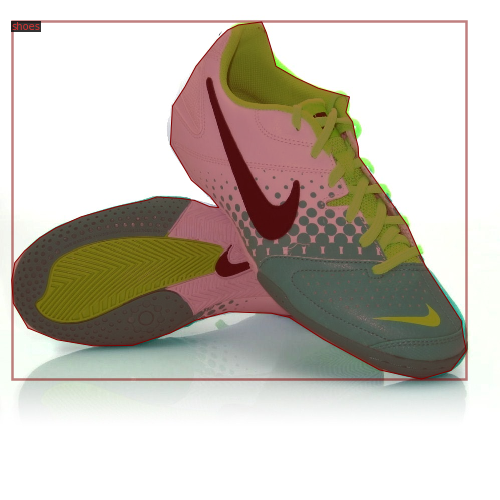

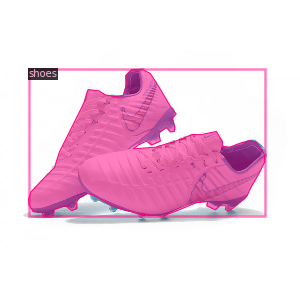

In [ ]:
##  Visualizimng some of the images with their masks ..

import random
for d in random.sample(dataset_dicts, 4):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=sample_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
##  Training the model on Shoes images ..

from detectron2 import model_zoo
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("sample_3",)
cfg.DATASETS.TEST = ()  
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = 300    # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1028   # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # 3 classes (Person, Helmet, Car)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/21 10:44:37 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/21 10:44:37 d2.engine.train_loop]: Starting training from iteration 0
[12/21 10:44:48 d2.utils.events]:  eta: 0:02:11  iter: 19  total_loss: 0.6613  loss_cls: 0.1424  loss_box_reg: 0.07446  loss_mask: 0.4875  loss_rpn_cls: 0.003761  loss_rpn_loc: 0.007481  time: 0.4800  data_time: 0.0302  lr: 0.0012854  max_mem: 6393M
[12/21 10:44:57 d2.utils.events]:  eta: 0:02:03  iter: 39  total_loss: 0.2606  loss_cls: 0.07651  loss_box_reg: 0.07946  loss_mask: 0.08501  loss_rpn_cls: 0.001679  loss_rpn_loc: 0.005085  time: 0.4840  data_time: 0.0049  lr: 0.0026174  max_mem: 6393M
[12/21 10:45:07 d2.utils.events]:  eta: 0:01:54  iter: 59  total_loss: 0.2022  loss_cls: 0.03234  loss_box_reg: 0.08053  loss_mask: 0.07184  loss_rpn_cls: 0.001022  loss_rpn_loc: 0.004815  time: 0.4870  data_time: 0.0054  lr: 0.0039494  max_mem: 6393M
[12/21 10:45:17 d2.utils.events]:  eta: 0:01:43  iter: 79  total_loss: 0.1379  loss_cls: 0.01733  loss_box_reg: 0.04151  loss_mask: 0.06367  loss_rpn_cls: 0.0007264  loss_r

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("sample_3", )
predictor = DefaultPredictor(cfg)

[12/21 10:47:51 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


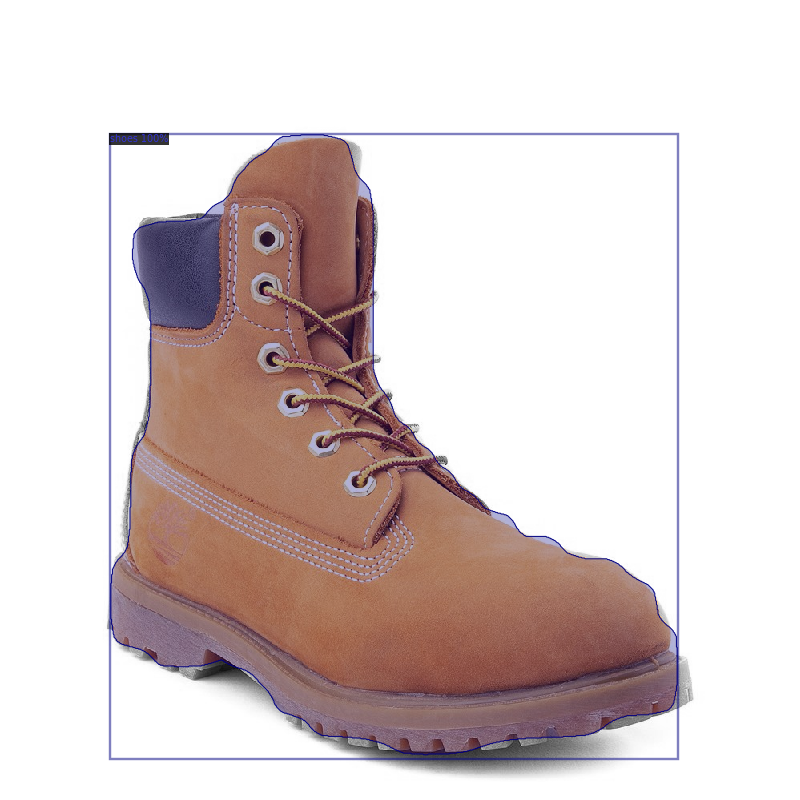

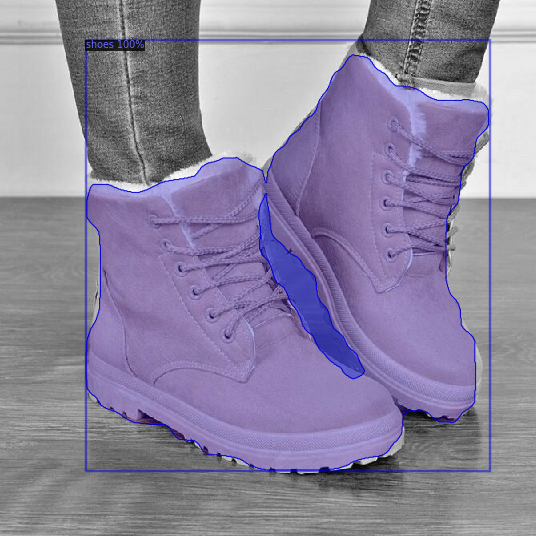

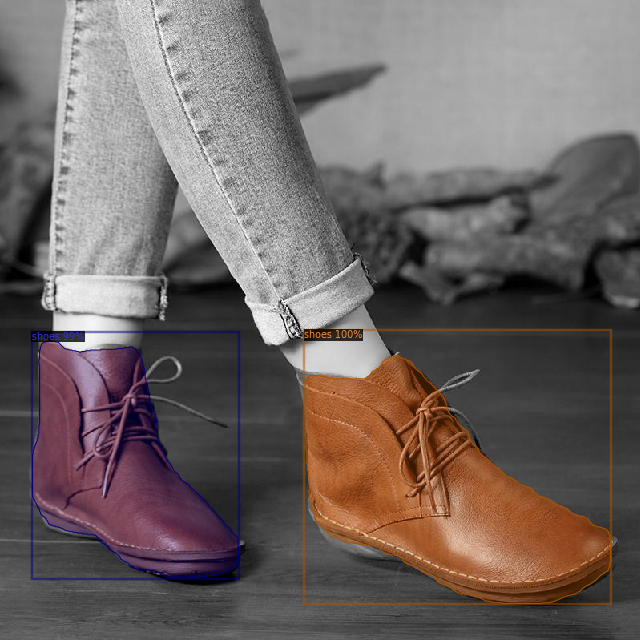

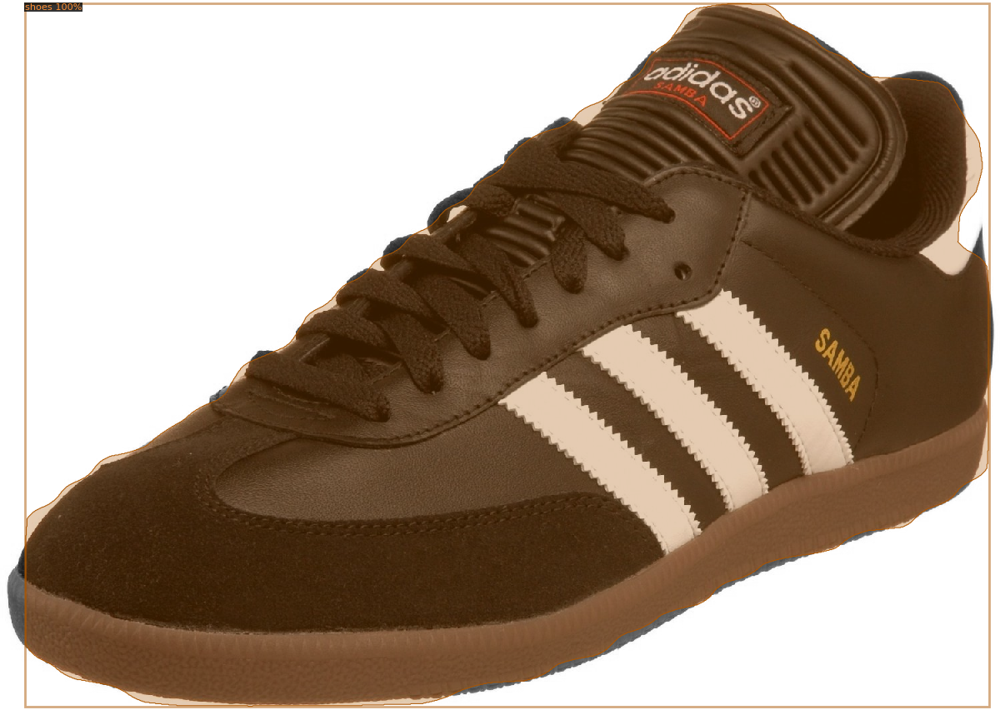

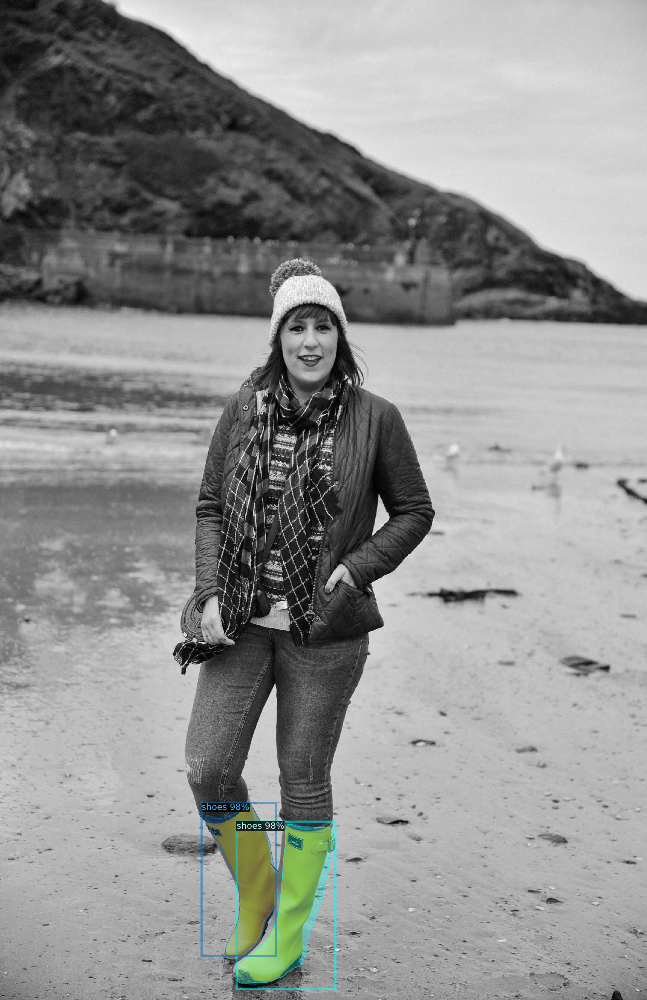

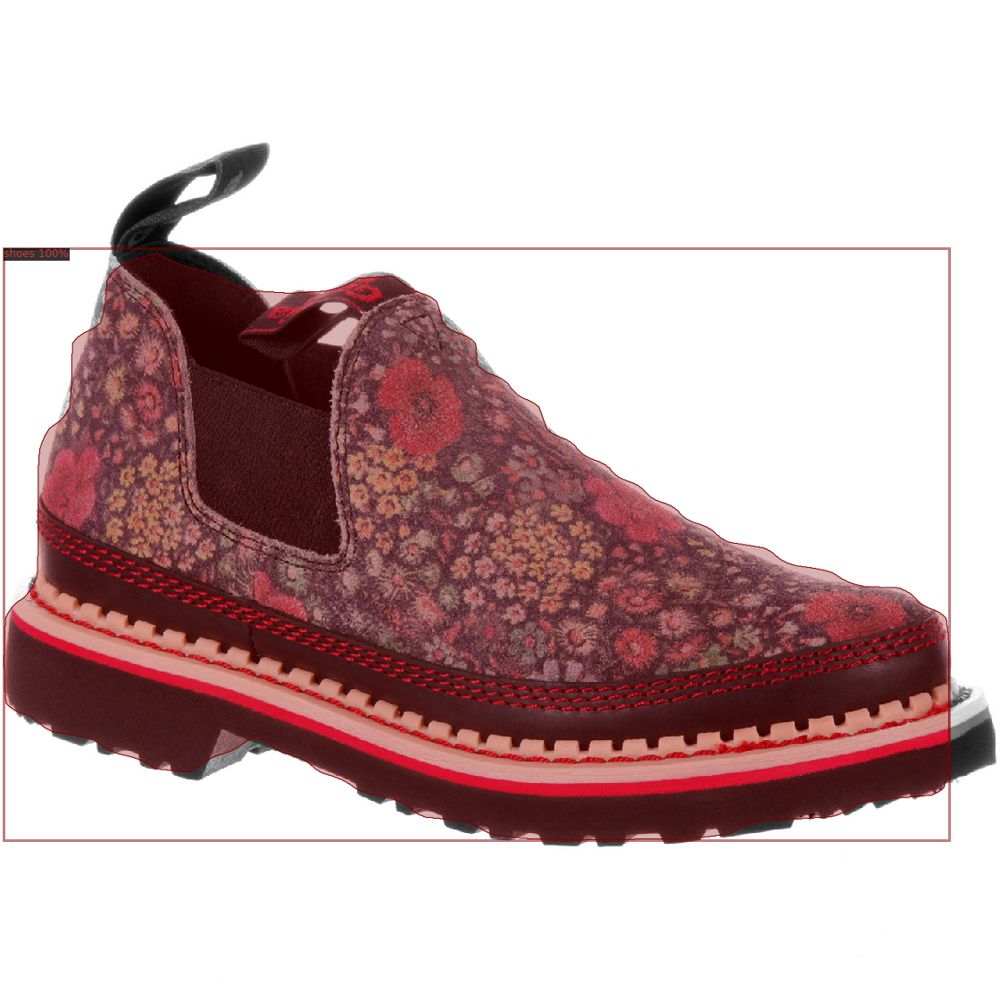

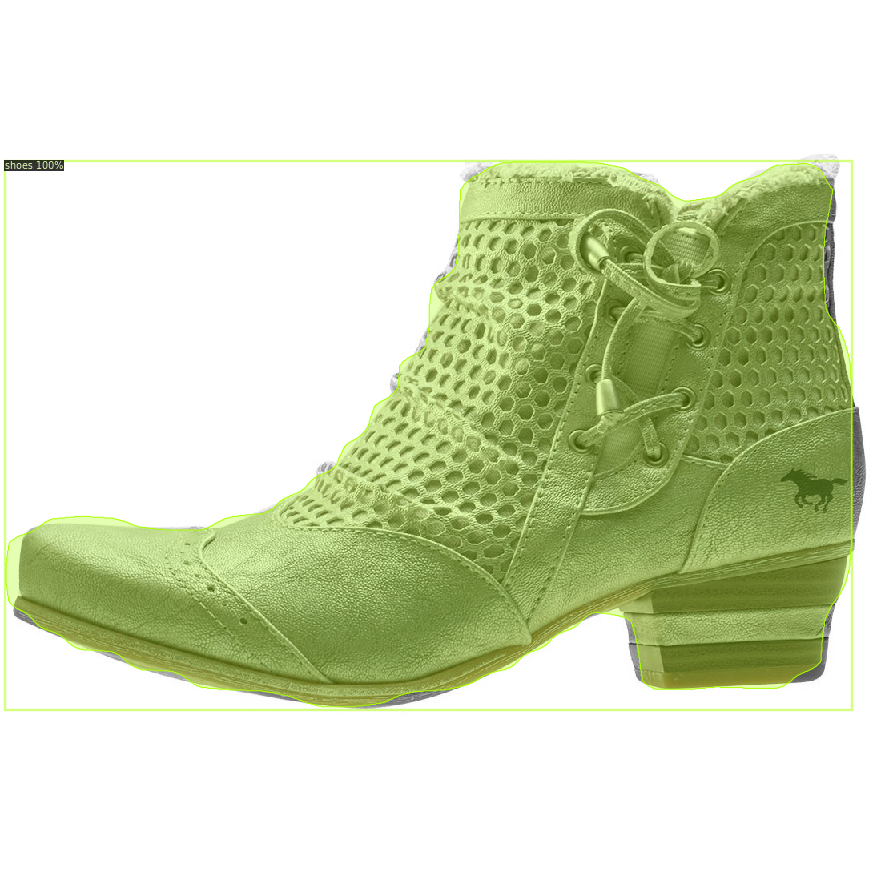

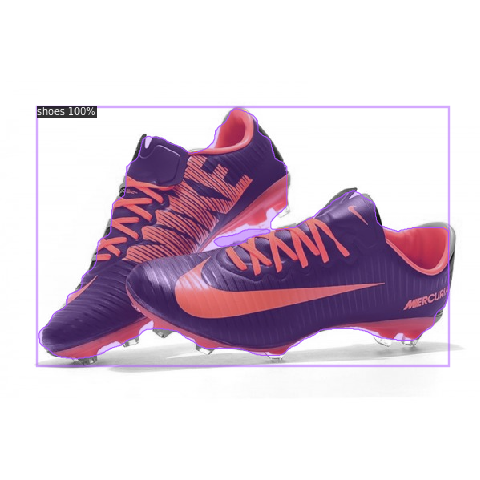

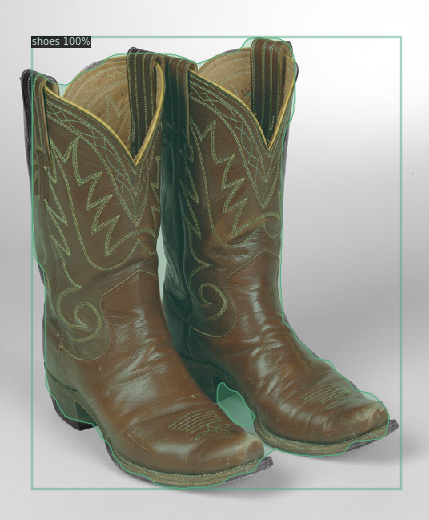

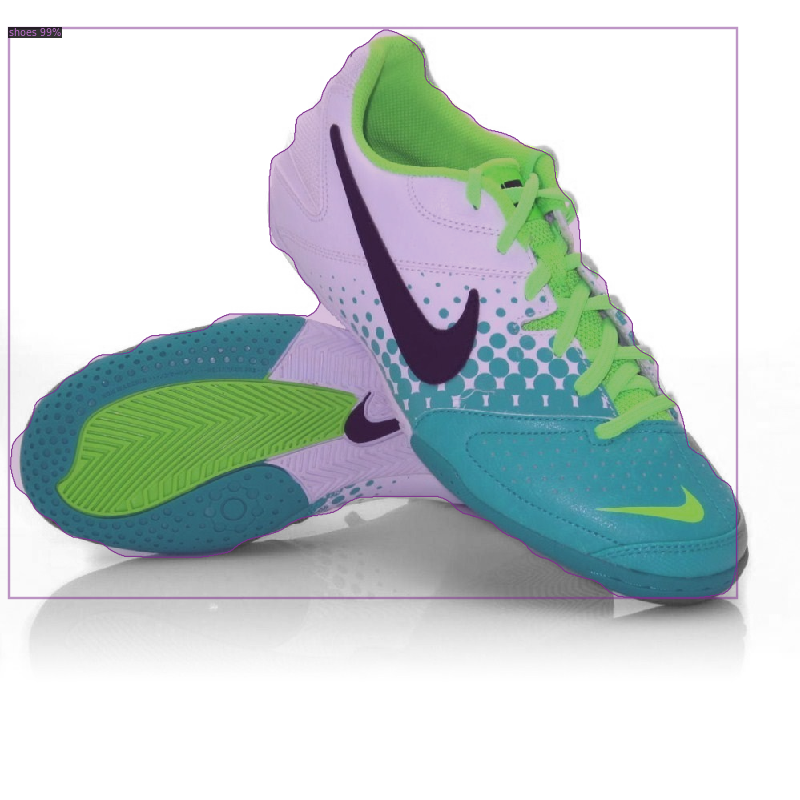

In [ ]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts, 10):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=sample_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [45]:
## We can also evaluate its performance using AP metric implemented in COCO API.

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator(dataset_dicts, output_dir="./output")
val_loader = build_detection_test_loader(cfg, dataset_dicts)
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

TypeError: ignored

In [ ]:
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1], metadata=sample_metadata, scale=0.5, instance_mode=ColorMode.IMAGE_BW)
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])